### Importing Libraries

In [14]:
import numpy as np
import matplotlib.pyplot as plt

In [15]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

### Importing Image Data

In [16]:
from tensorflow.keras.utils import image_dataset_from_directory

train_dataset = image_dataset_from_directory(
    'Dataset for CA1 part A - AY2425S1\\train', 
    labels="inferred", 
    label_mode="categorical", 
    color_mode="grayscale", 
    batch_size=None, 
    image_size=(137, 137), 
    shuffle=False
    )

train_dataset_37 = image_dataset_from_directory(
    'Dataset for CA1 part A - AY2425S1\\train', 
    labels="inferred", 
    label_mode="categorical", 
    color_mode="grayscale", 
    batch_size=200000, 
    image_size=(37, 37), 
    shuffle=False)

test_dataset_37 = image_dataset_from_directory(
    'Dataset for CA1 part A - AY2425S1\\test', 
    labels="inferred", 
    label_mode="categorical", 
    color_mode="grayscale", 
    batch_size=200000, 
    image_size=(37, 37), 
    shuffle=False)

validate_dataset_37 = image_dataset_from_directory(
    'Dataset for CA1 part A - AY2425S1\\validation', 
    labels="inferred", 
    label_mode="categorical", 
    color_mode="grayscale", 
    batch_size=200000, 
    image_size=(37, 37), 
    shuffle=False)

train_dataset_131 = image_dataset_from_directory(
    'Dataset for CA1 part A - AY2425S1\\train', 
    labels="inferred", 
    label_mode="categorical", 
    color_mode="grayscale", 
    batch_size=200000, 
    image_size=(131, 131), 
    shuffle=False)

test_dataset_131 = image_dataset_from_directory(
    'Dataset for CA1 part A - AY2425S1\\test', 
    labels="inferred", 
    label_mode="categorical", 
    color_mode="grayscale", 
    batch_size=200000, 
    image_size=(131, 131), 
    shuffle=False)

validate_dataset_131 = image_dataset_from_directory(
    'Dataset for CA1 part A - AY2425S1\\validation', 
    labels="inferred", 
    label_mode="categorical", 
    color_mode="grayscale", 
    batch_size=200000, 
    image_size=(131, 131), 
    shuffle=False)

Found 9032 files belonging to 15 classes.
Found 9032 files belonging to 15 classes.
Found 3000 files belonging to 15 classes.
Found 3000 files belonging to 15 classes.
Found 9032 files belonging to 15 classes.
Found 3000 files belonging to 15 classes.
Found 3000 files belonging to 15 classes.


In [ ]:
images = []
for i in range(0, len(train_dataset.class_names)):
    images_temp = []
    for x, y in train_dataset:
        if np.where(y)[0][0] == i:
            images_temp.append(x.numpy())
    images.append(images_temp)

In [17]:
X_train37 = []
y_train37 = []

for x, y in train_dataset_37:
    X_train37.append(x.numpy())
    y_train37.append(y.numpy())

X_test37 = []
y_test37 = []

for x, y in test_dataset_37:
    X_test37.append(x.numpy())
    y_test37.append(y.numpy())

X_validate37 = []
y_validate37 = []

for x, y in validate_dataset_37:
    X_validate37.append(x.numpy())
    y_validate37.append(y.numpy())

X_train131 = []
y_train131 = []

for x, y in train_dataset_131:
    X_train131.append(x.numpy())
    y_train131.append(y.numpy())

X_test131 = []
y_test131 = []

for x, y in test_dataset_131:
    X_test131.append(x.numpy())
    y_test131.append(y.numpy())

X_validate131 = []
y_validate131 = []

for x, y in validate_dataset_131:
    X_validate131.append(x.numpy())
    y_validate131.append(y.numpy())

In [18]:
X_train37 = np.concatenate(X_train37, axis=0)
y_train37 = np.concatenate(y_train37, axis=0)

X_test37 = np.concatenate(X_test37, axis=0)
y_test37 = np.concatenate(y_test37, axis=0)

X_validate37 = np.concatenate(X_validate37, axis=0)
y_validate37 = np.concatenate(y_validate37, axis=0)

X_train131 = np.concatenate(X_train131, axis=0)
y_train131 = np.concatenate(y_train131, axis=0)

X_test131 = np.concatenate(X_test131, axis=0)
y_test131 = np.concatenate(y_test131, axis=0)

X_validate131 = np.concatenate(X_validate131, axis=0)
y_validate131 = np.concatenate(y_validate131, axis=0)

Normalise the image data

In [19]:
X_train37 = X_train37 / 255
X_test37 = X_test37 / 255
X_validate37 = X_validate37 / 255

### Exploratory Data Analysis

#### PCA to analyse dataset and flag outliers

After manually checking through the dataset and manually removing data which isn't supposed to belong to a class (i.e. carrots in beans), doing PCA can help us to 'double-check' if we have actually gotten all of the misplaced data.

In [9]:
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error

outlier_images = []
progress = 0

for class_images in images:
    pca = PCA(n_components=len(class_images))
    X_pca = pca.fit_transform([i.flatten() for i in class_images])
    X_reconstructed = pca.inverse_transform(X_pca)
    reconstruction_errors = [mean_squared_error([i.flatten() for i in class_images][i], X_reconstructed[i]) for i in range(len([i.flatten() for i in class_images]))]
    threshold = np.percentile(reconstruction_errors, 85)
    outliers_indices = np.where(reconstruction_errors > threshold)[0]
    outlier_images.append([class_images[i] for i in outliers_indices])
    progress += 1
    print(f"Finsished with {progress}/{len(images)}. Total images: {len(class_images)} Total outliers: {len(outliers_indices)}")

Finsished with 1/15. Total images: 792 Total outliers: 119
Finsished with 2/15. Total images: 720 Total outliers: 108
Finsished with 3/15. Total images: 441 Total outliers: 66
Finsished with 4/15. Total images: 868 Total outliers: 131
Finsished with 5/15. Total images: 750 Total outliers: 113
Finsished with 6/15. Total images: 503 Total outliers: 76
Finsished with 7/15. Total images: 351 Total outliers: 53
Finsished with 8/15. Total images: 256 Total outliers: 39
Finsished with 9/15. Total images: 587 Total outliers: 88
Finsished with 10/15. Total images: 812 Total outliers: 122
Finsished with 11/15. Total images: 566 Total outliers: 85
Finsished with 12/15. Total images: 377 Total outliers: 57
Finsished with 13/15. Total images: 814 Total outliers: 122
Finsished with 14/15. Total images: 248 Total outliers: 38
Finsished with 15/15. Total images: 955 Total outliers: 144


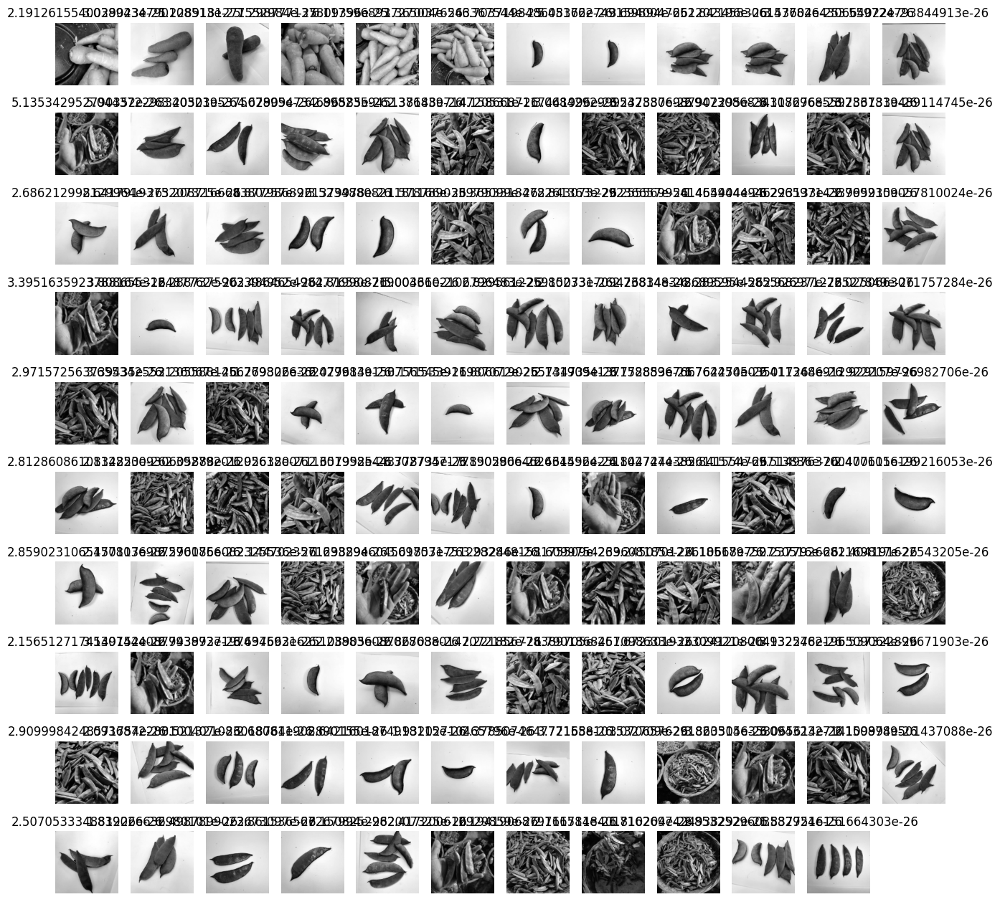

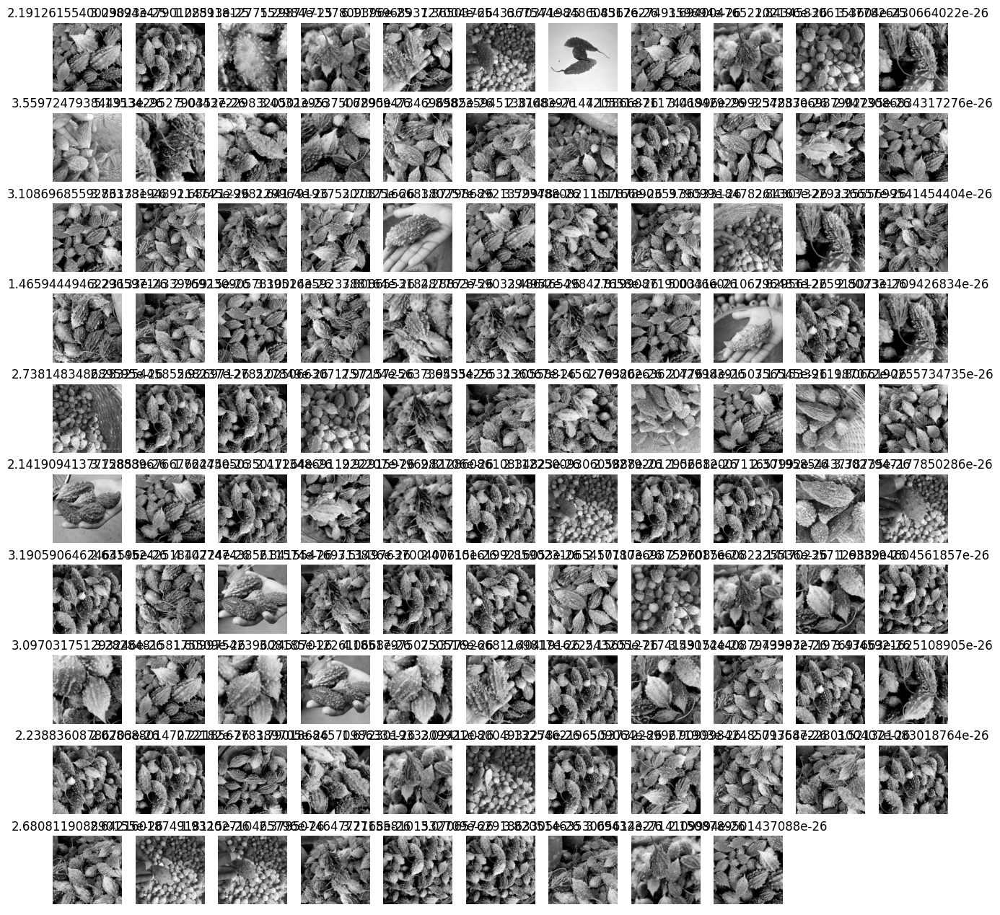

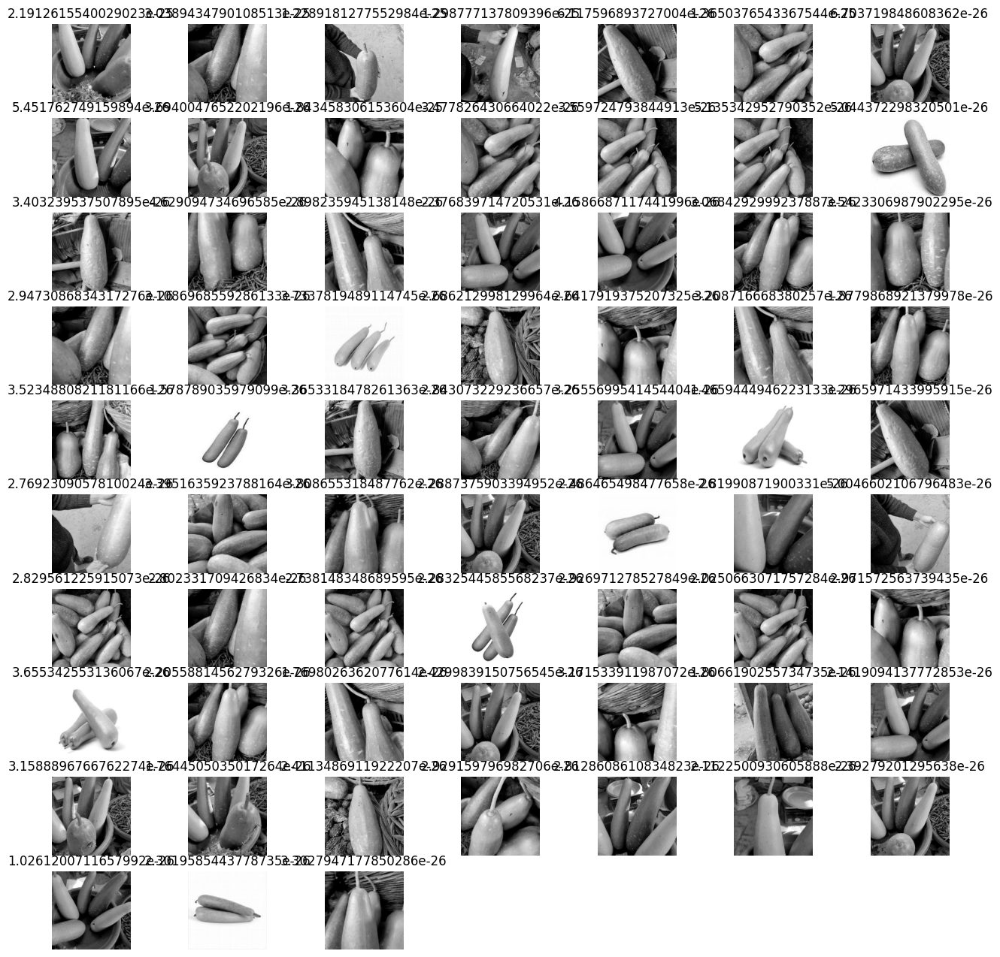

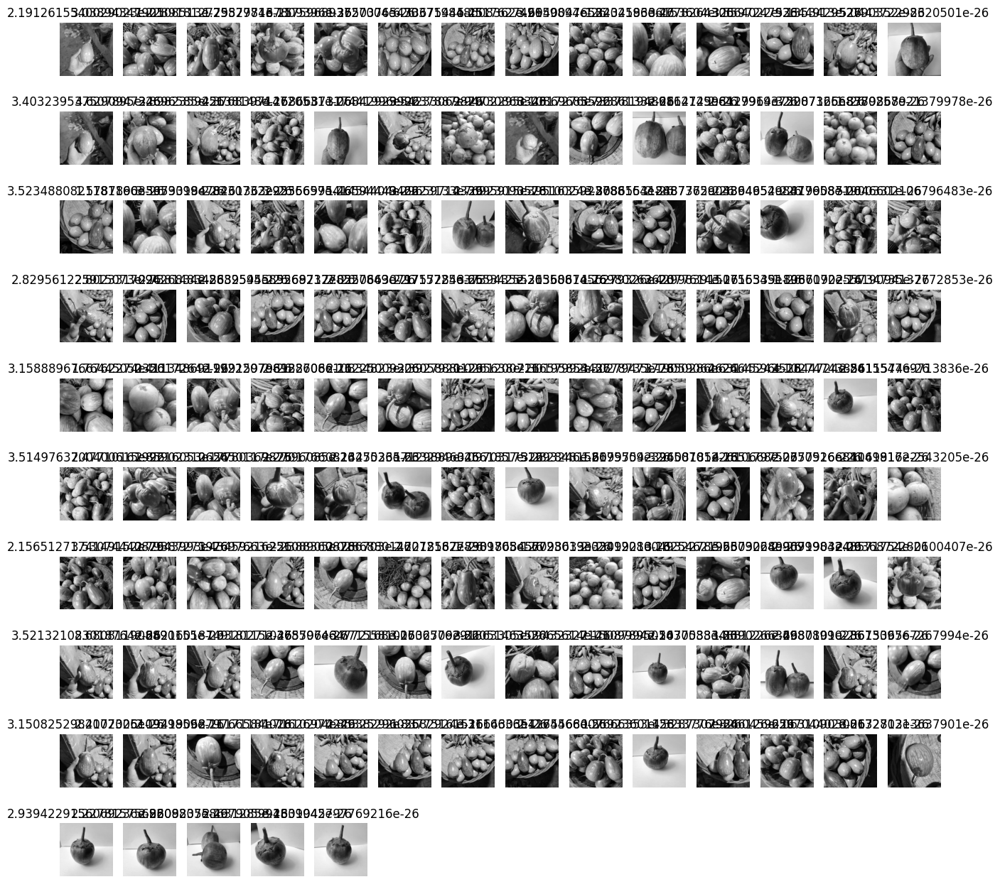

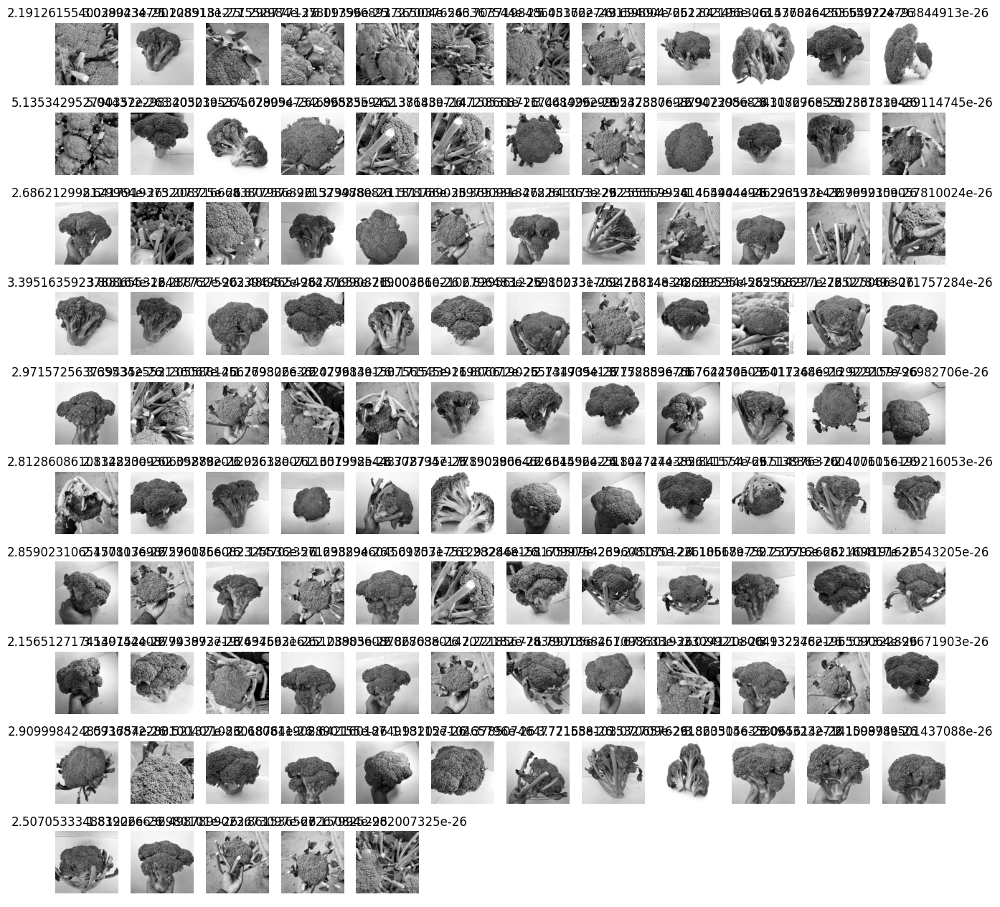

...

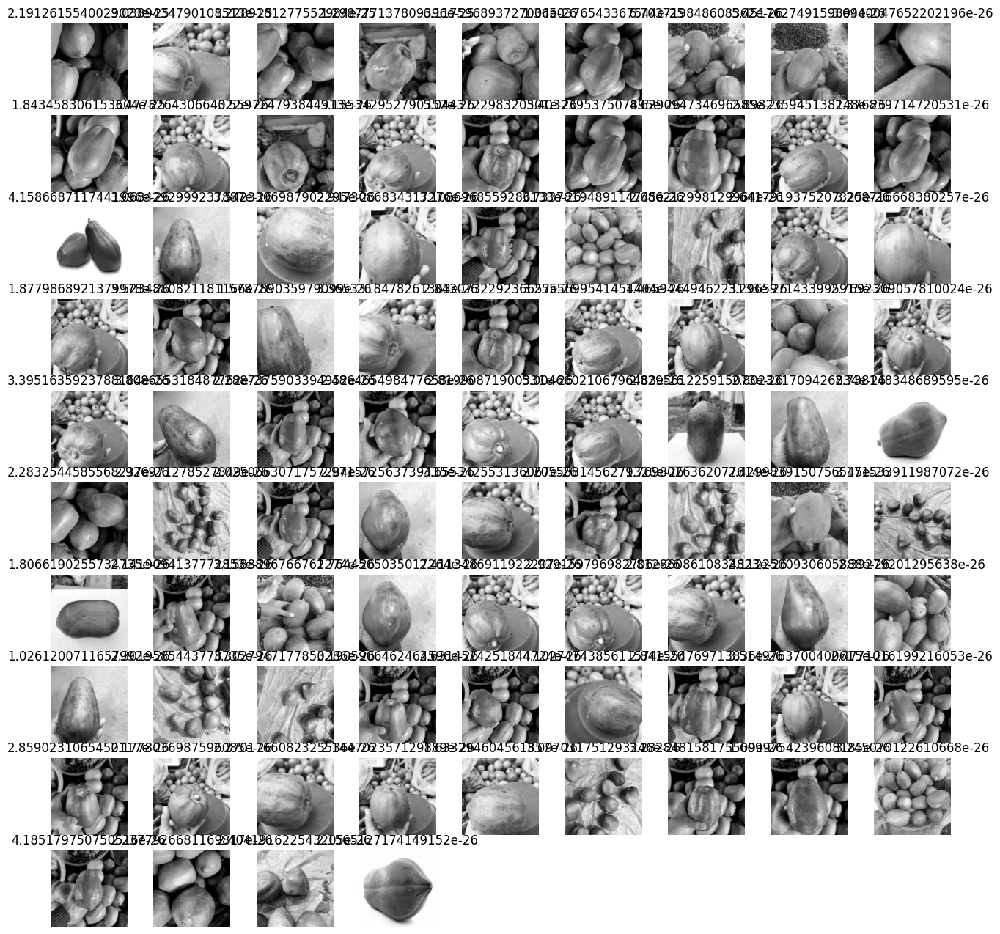

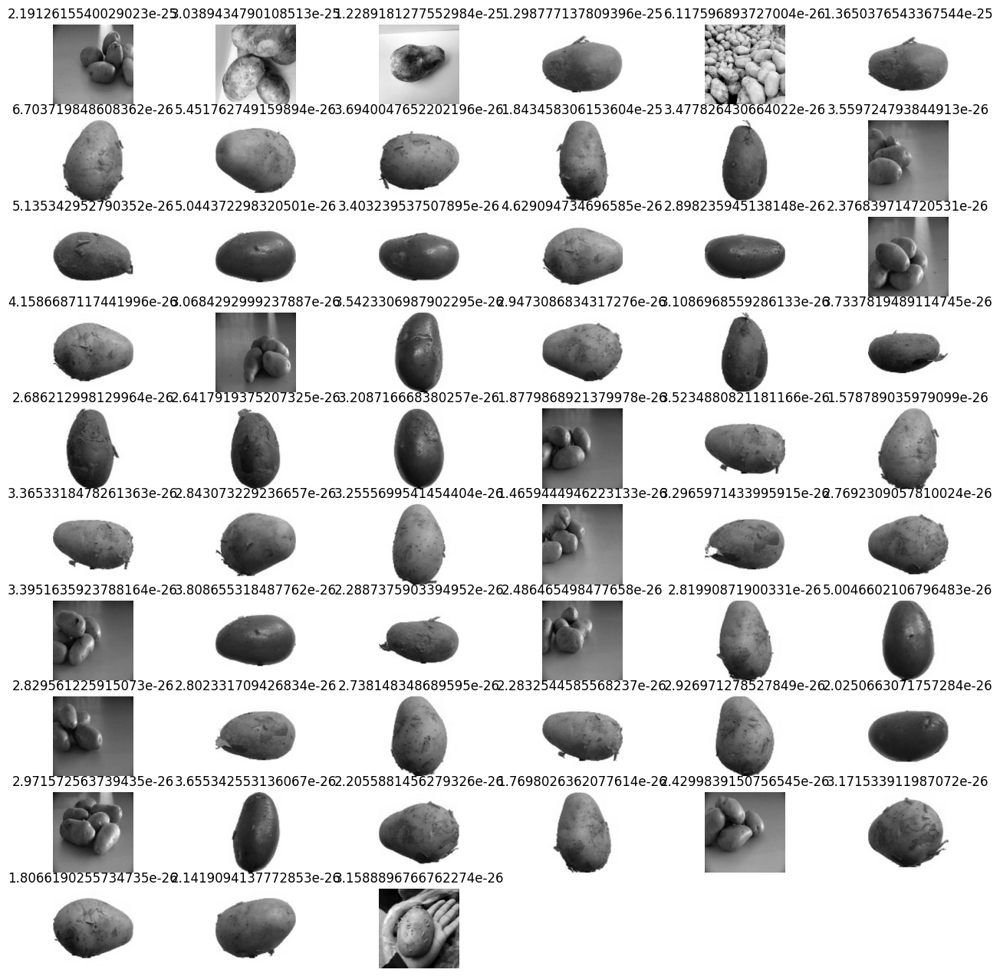

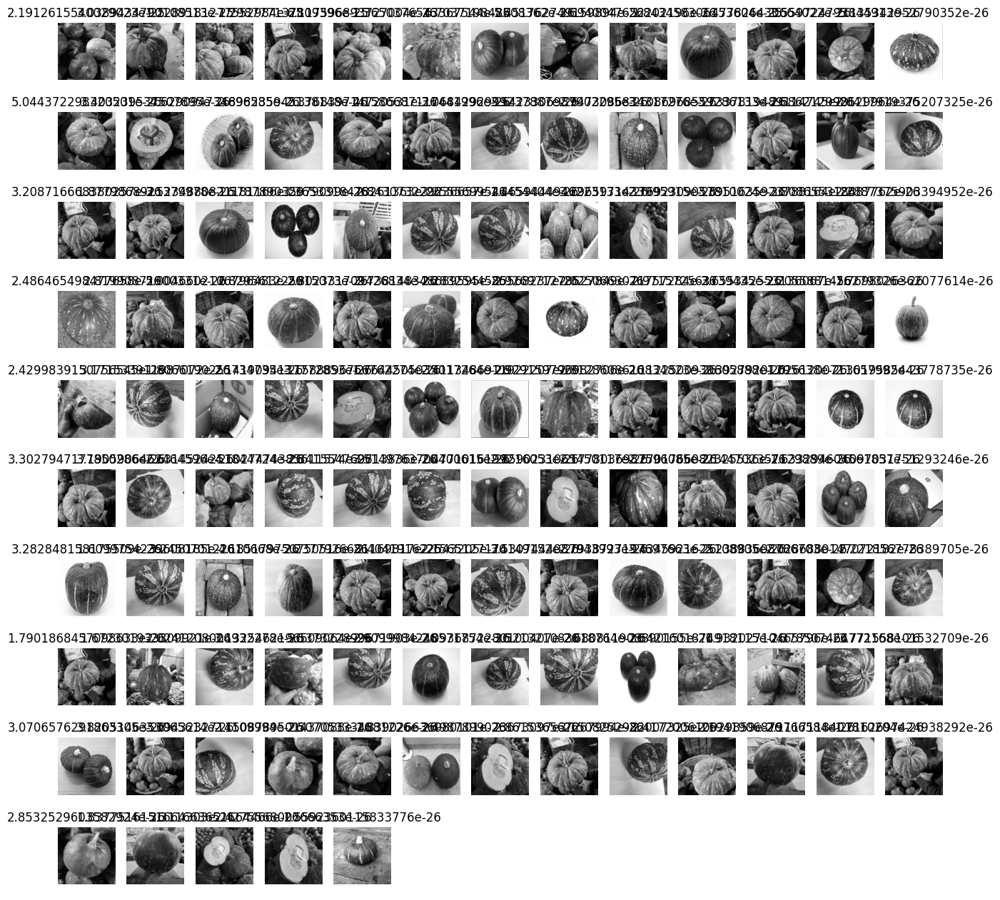

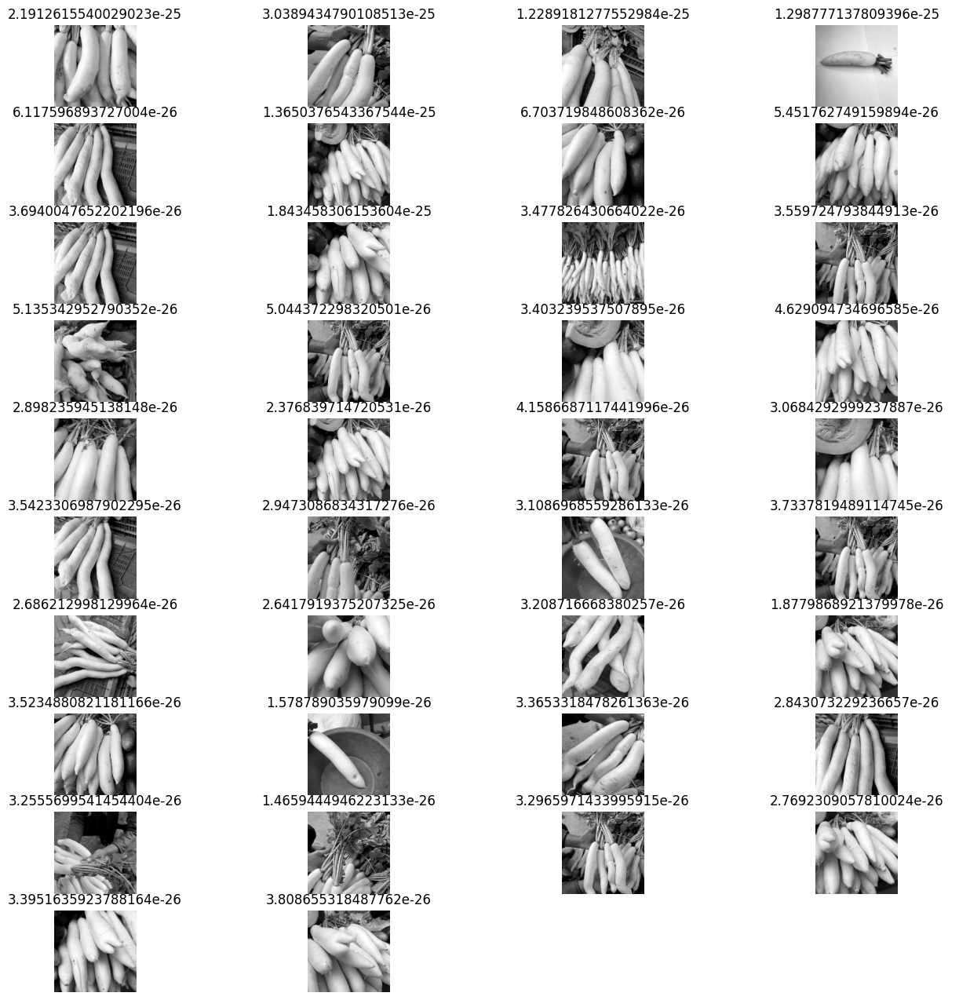

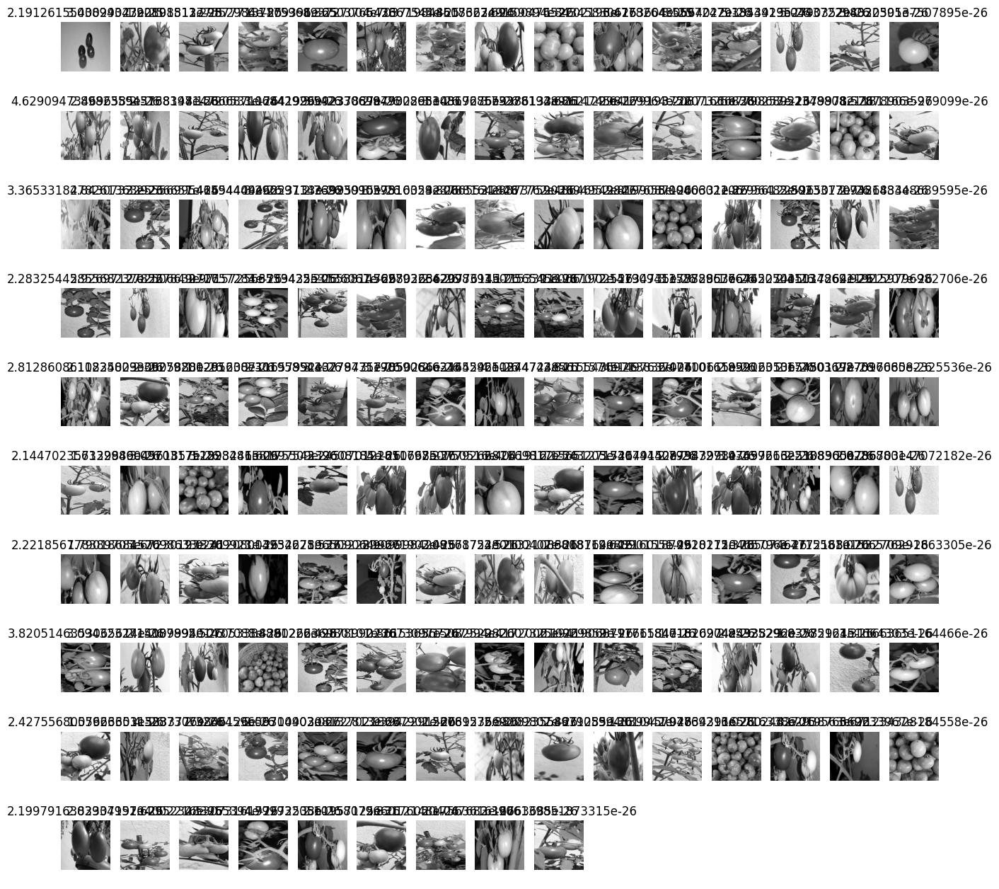

In [15]:
import matplotlib.pyplot as plt

for outlier_images_data in outlier_images:
    num_rows = 10
    num_cols = (len(outlier_images_data) + num_rows - 1) // num_rows

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(16, 16))

    if num_rows == 1 and num_cols == 1:
        axes = np.array([[axes]])

    for i, ax_row in enumerate(axes):
        for j, ax in enumerate(ax_row):
            index = i * num_cols + j
            if index < len(outlier_images_data):
                ax.imshow(outlier_images_data[index], cmap='gray')
                ax.set_title(f'{reconstruction_errors[index]}')
                ax.axis('off')
            else:
                ax.axis('off')
    
    plt.show()

For the bean dataset, the PCA has helped to detect some carrots which I missed out as outliers.

PCA can also aid in data exploration for the dataset. For some datasets like potato and capsicum, most of the images PCA has picked out are those with a light background and have only one or few of those items.

However, I won't remove those outliers as the images in the train and validation dataset have the same type of images.

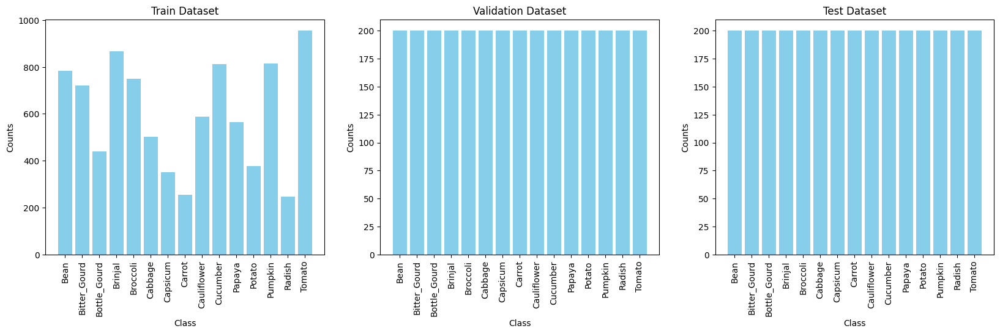

In [56]:
class_counts_train = np.sum(y_train37, axis=0)
class_labels_train = [f'{train_dataset_37.class_names[i]}' for i in range(len(class_counts_train))]

class_counts_validate = np.sum(y_validate37, axis=0)
class_labels_validate = [f'{validate_dataset_37.class_names[i]}' for i in range(len(class_counts_validate))]

class_counts_test = np.sum(y_test37, axis=0)
class_labels_test = [f'{test_dataset_37.class_names[i]}' for i in range(len(class_counts_test))]

# Plotting
fig, (ax1, ax2, ax3) = plt.subplots(1,3)
fig.set_size_inches(20, 5)

ax1.bar(class_labels_train, class_counts_train, color='skyblue')
ax1.set_xlabel('Class')
ax1.set_ylabel('Counts')
ax1.set_title('Train Dataset')
ax1.xaxis.set_tick_params(rotation=90)

ax2.bar(class_labels_validate, class_counts_validate, color='skyblue')
ax2.set_xlabel('Class')
ax2.set_ylabel('Counts')
ax2.set_title('Validation Dataset')
ax2.xaxis.set_tick_params(rotation=90)

ax3.bar(class_labels_test, class_counts_test, color='skyblue')
ax3.set_xlabel('Class')
ax3.set_ylabel('Counts')
ax3.set_title('Test Dataset')
ax3.xaxis.set_tick_params(rotation=90)

plt.show()

As you can see, there are class imbalances in the train dataset only. Carrot and Radish has the lowest number of images in its dataset.

To help counter the class imbalance, we will use class weights when fitting the models.

In [24]:
from sklearn.utils.class_weight import compute_class_weight

def generate_class_weights(class_series): 
    class_series = np.argmax(class_series, axis=1)
  
    class_labels = np.unique(class_series)
    class_weights = compute_class_weight(class_weight='balanced', classes=class_labels, y=class_series)
    return dict(zip(class_labels, class_weights))
  
labels = np.array([label.numpy() for _, label in train_dataset_37.unbatch()])
class_weights = generate_class_weights(labels)

## Creating the model for 37x37 images

In [25]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, MaxPooling2D, Dropout, BatchNormalization

In [26]:
# fix random seed for reproducibility
seed = 88
np.random.seed(seed)

In [27]:
from tensorflow.keras.optimizers import Adam

model37 = Sequential()

model37.add(Conv2D(32, (3, 3), activation='relu', input_shape=(37, 37, 1)))
model37.add(BatchNormalization())
model37.add(MaxPooling2D((2, 2)))

model37.add(Conv2D(64, (3, 3), activation='relu'))
model37.add(BatchNormalization())
model37.add(Dropout(0.1))
model37.add(MaxPooling2D((2, 2)))

model37.add(Conv2D(64, (3, 3), activation='relu'))
model37.add(BatchNormalization())
model37.add(Dropout(0.5))

model37.add(Flatten())

model37.add(Dense(100, activation='relu'))
model37.add(Dropout(0.15)) # Dropout for regularization

model37.add(Dense(50, activation='relu'))
model37.add(Dropout(0.1)) # Dropout for regularization

model37.add(Dense(15, activation='softmax'))

optimizer = Adam(learning_rate=0.00009)

model37.compile(optimizer=optimizer,
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model37.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 35, 35, 32)        320       
                                                                 
 batch_normalization_3 (Batc  (None, 35, 35, 32)       128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 17, 17, 32)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 15, 15, 64)        18496     
                                                                 
 batch_normalization_4 (Batc  (None, 15, 15, 64)       256       
 hNormalization)                                                 
                                                      

To improve the model, I added dropout to prevent overfitting, added BatchNormalization between layers to stabilize the distributions of layer inputs and MaxPooling2D to downsample the data and extract the most important information.

The learning rate of Adam was set to 0.00009 to help reduce volatility in the loss and accuracy scores.

This model has a total of 221,979 trainable parameters

In [28]:
history37 = model37.fit(X_train37, y_train37, validation_data=(X_validate37, y_validate37), epochs=300, batch_size=50, verbose=1, class_weight=class_weights)

Epoch 1/300
181/181 [==============================] - 12s 9ms/step - loss: 3.0627 - accuracy: 0.1032 - val_loss: 2.7516 - val_accuracy: 0.0743
Epoch 2/300
181/181 [==============================] - 1s 7ms/step - loss: 2.6166 - accuracy: 0.1611 - val_loss: 2.6903 - val_accuracy: 0.1093
Epoch 3/300
181/181 [==============================] - 1s 7ms/step - loss: 2.3602 - accuracy: 0.2277 - val_loss: 2.2901 - val_accuracy: 0.2510
Epoch 4/300
181/181 [==============================] - 1s 7ms/step - loss: 2.2155 - accuracy: 0.2819 - val_loss: 1.8849 - val_accuracy: 0.4030
Epoch 5/300
181/181 [==============================] - 1s 7ms/step - loss: 2.0397 - accuracy: 0.3282 - val_loss: 1.7183 - val_accuracy: 0.4690
Epoch 6/300
181/181 [==============================] - 1s 7ms/step - loss: 1.9165 - accuracy: 0.3720 - val_loss: 1.5841 - val_accuracy: 0.5110
Epoch 7/300
181/181 [==============================] - 1s 7ms/step - loss: 1.7899 - accuracy: 0.4101 - val_loss: 1.5190 - val_accuracy: 0.531

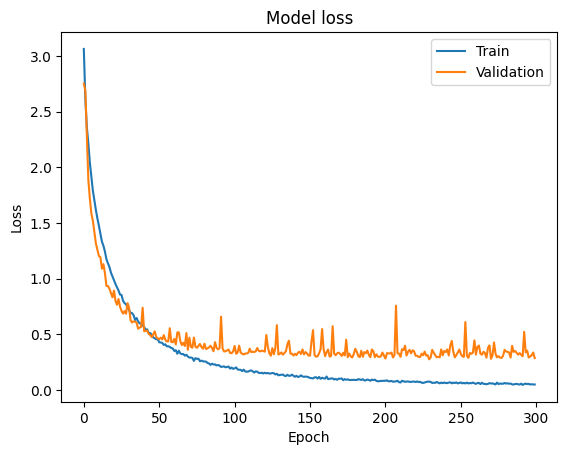

In [29]:
plt.figure()
plt.plot(history37.history["loss"])
plt.plot(history37.history["val_loss"])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

From the model loss graph, there is no overfitting of the model onto the training data.

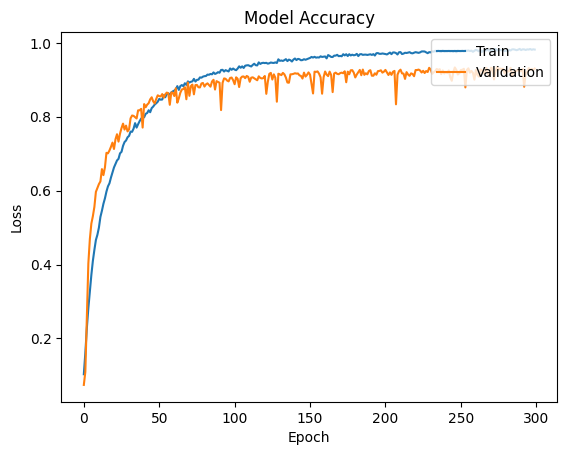

In [30]:
plt.figure()
plt.plot(history37.history["accuracy"])
plt.plot(history37.history["val_accuracy"])
plt.title('Model Accuracy')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

In [31]:
model37.save('model37.h5')
model37.save_weights('model37_weights.h5')

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 35, 35, 32)        320       
                                                                 
 batch_normalization_3 (Batc  (None, 35, 35, 32)       128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 17, 17, 32)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 15, 15, 64)        18496     
                                                                 
 batch_normalization_4 (Batc  (None, 15, 15, 64)       256       
 hNormalization)                                                 
                                                      

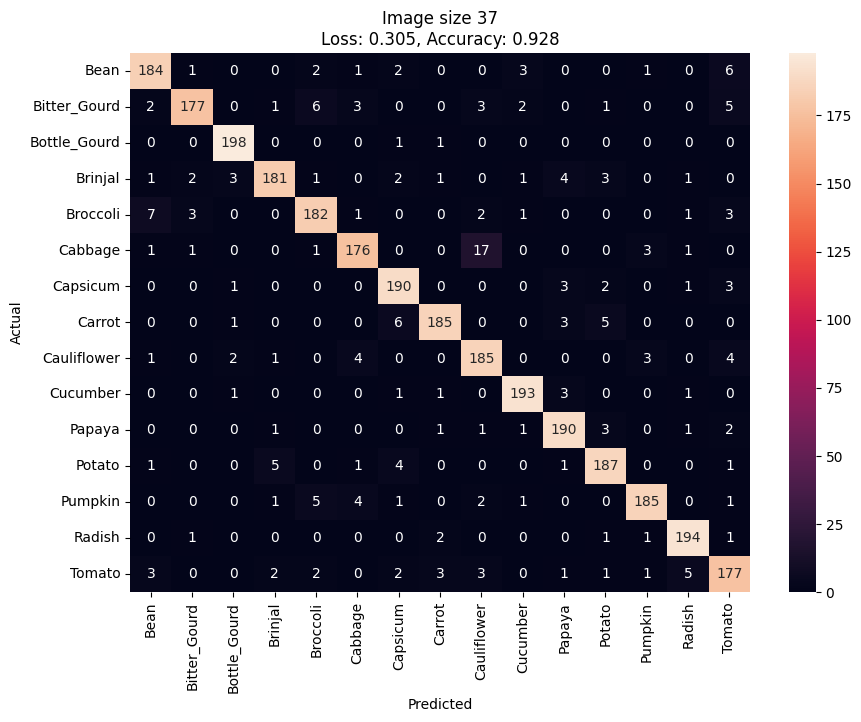

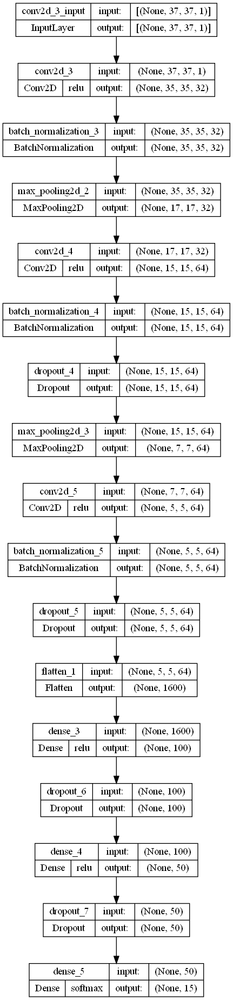

In [32]:
#import model and weights
from tensorflow.keras.models import load_model
from keras.utils.vis_utils import plot_model

model37 = load_model('model37.h5')

model37.load_weights('model37_weights.h5')

model37.summary()

y_pred = model37.predict(X_test37)

from sklearn.metrics import confusion_matrix

confusion_matrix(np.argmax(y_test37, axis=1), np.argmax(y_pred, axis=1))

# Graph the confusion matrix

import seaborn as sns
import pandas as pd

cm = confusion_matrix(np.argmax(y_test37, axis=1), np.argmax(y_pred, axis=1))

pd.options.display.float_format = '{:.2f}'.format

df_cm = pd.DataFrame(cm, index = [i for i in test_dataset_37.class_names],
                    columns = [i for i in test_dataset_37.class_names])

loss, accuracy = model37.evaluate(X_test37, y_test37)

plt.figure(figsize=(10,7))
sns.heatmap(df_cm, annot=True, fmt='d')
plt.title(f'Image size 37\nLoss: {loss:.3f}, Accuracy: {accuracy:.3f}')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

plot_model(model37, show_shapes=True, show_layer_names=True, show_layer_activations=True, expand_nested=True)

The 37x37 Model has a loss of 0.305 and an accuracy of 92.8% when tested on the testing data.

From the confusion matrix, you can see that the model doesn’t do so well on predicting cabbages as 17 cabbages were classified as cauliflower instead.

## Creating the model for 131x131 images

In [33]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, MaxPooling2D, Dropout, BatchNormalization

In [34]:
# fix random seed for reproducibility
seed = 88
np.random.seed(seed)

In [36]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Conv2D, BatchNormalization, MaxPooling2D, Dropout, GlobalAveragePooling2D, Dense
from tensorflow.keras.models import Sequential

model131 = Sequential()

model131.add(Conv2D(32, (3, 3), activation='relu', input_shape=(131, 131, 1)))
model131.add(BatchNormalization())
model131.add(MaxPooling2D((2, 2)))

model131.add(Conv2D(64, (3, 3), activation='relu'))
model131.add(BatchNormalization())
model131.add(MaxPooling2D((2, 2)))

model131.add(Conv2D(128, (3, 3), activation='relu'))
model131.add(BatchNormalization())
model131.add(Dropout(0.3))
model131.add(MaxPooling2D((2, 2)))

model131.add(Conv2D(256, (3, 3), activation='relu'))
model131.add(BatchNormalization())
model131.add(Dropout(0.4))
model131.add(MaxPooling2D((2, 2)))

model131.add(GlobalAveragePooling2D())

model131.add(Dense(100, activation='relu'))
model131.add(Dropout(0.3))

model131.add(Dense(50, activation='relu'))
model131.add(Dropout(0.2))

model131.add(Dense(15, activation='softmax'))

optimizer = Adam(learning_rate=0.00002)

model131.compile(optimizer=optimizer,
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model131.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 129, 129, 32)      320       
                                                                 
 batch_normalization_9 (Batc  (None, 129, 129, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 62, 62, 64)        18496     
                                                                 
 batch_normalization_10 (Bat  (None, 62, 62, 64)       256       
 chNormalization)                                                
                                                      

To improve the model, I added dropout to prevent overfitting, added BatchNormalization between layers to stabilize the distributions of layer inputs and MaxPooling2D to downsample the data and extract the most important information.

More layers were used and there are more neurons compared to the 37x37 model as there is more data to train on.

The learning rate of Adam was set to 0.00002 to help reduce volatility in the loss and accuracy scores.

This model has a total of 420,315 trainable parameters

In [37]:
history131 = model131.fit(X_train131, y_train131, validation_data=(X_validate131, y_validate131), epochs=250, batch_size=50, verbose=1, class_weight=class_weights)

Epoch 1/250
181/181 [==============================] - 15s 72ms/step - loss: 2.9153 - accuracy: 0.1256 - val_loss: 2.5867 - val_accuracy: 0.1423
Epoch 2/250
181/181 [==============================] - 12s 65ms/step - loss: 2.4182 - accuracy: 0.2059 - val_loss: 2.2730 - val_accuracy: 0.3317
Epoch 3/250
181/181 [==============================] - 12s 65ms/step - loss: 2.2032 - accuracy: 0.2864 - val_loss: 2.0299 - val_accuracy: 0.4260
Epoch 4/250
181/181 [==============================] - 12s 67ms/step - loss: 2.0492 - accuracy: 0.3475 - val_loss: 1.9246 - val_accuracy: 0.4677
Epoch 5/250
181/181 [==============================] - 12s 66ms/step - loss: 1.9394 - accuracy: 0.3841 - val_loss: 1.8143 - val_accuracy: 0.4870
Epoch 6/250
181/181 [==============================] - 12s 66ms/step - loss: 1.8540 - accuracy: 0.4161 - val_loss: 1.7413 - val_accuracy: 0.5080
Epoch 7/250
181/181 [==============================] - 12s 66ms/step - loss: 1.7551 - accuracy: 0.4432 - val_loss: 1.6793 - val_ac

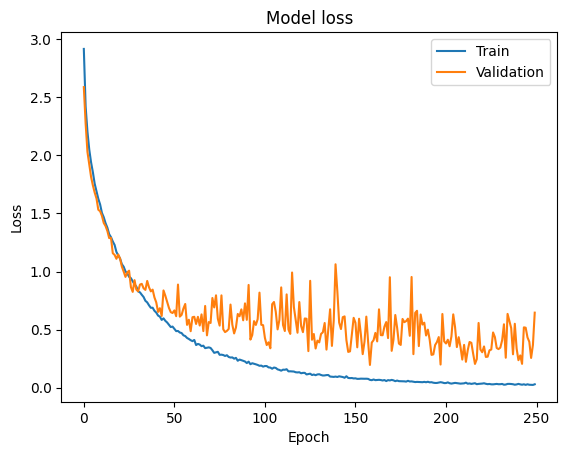

In [38]:
plt.figure()
plt.plot(history131.history["loss"])
plt.plot(history131.history["val_loss"])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

From the model loss graph, there is no overfitting of the model onto the training data.

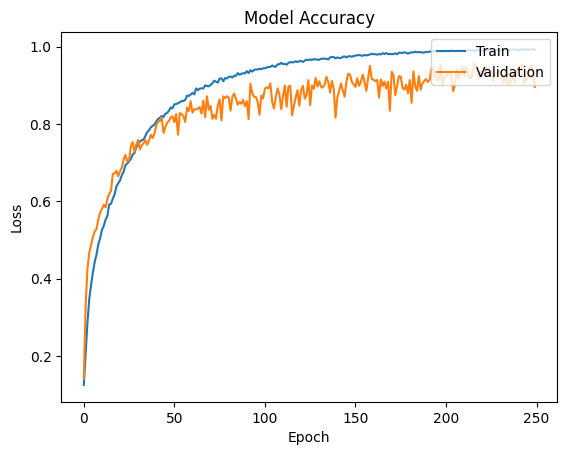

In [39]:
plt.figure()
plt.plot(history131.history["accuracy"])
plt.plot(history131.history["val_accuracy"])
plt.title('Model Accuracy')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

In [40]:
model131.save('model131.h5')
model131.save_weights('model131_weights.h5')

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 129, 129, 32)      320       
                                                                 
 batch_normalization_9 (Batc  (None, 129, 129, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 62, 62, 64)        18496     
                                                                 
 batch_normalization_10 (Bat  (None, 62, 62, 64)       256       
 chNormalization)                                                
                                                      

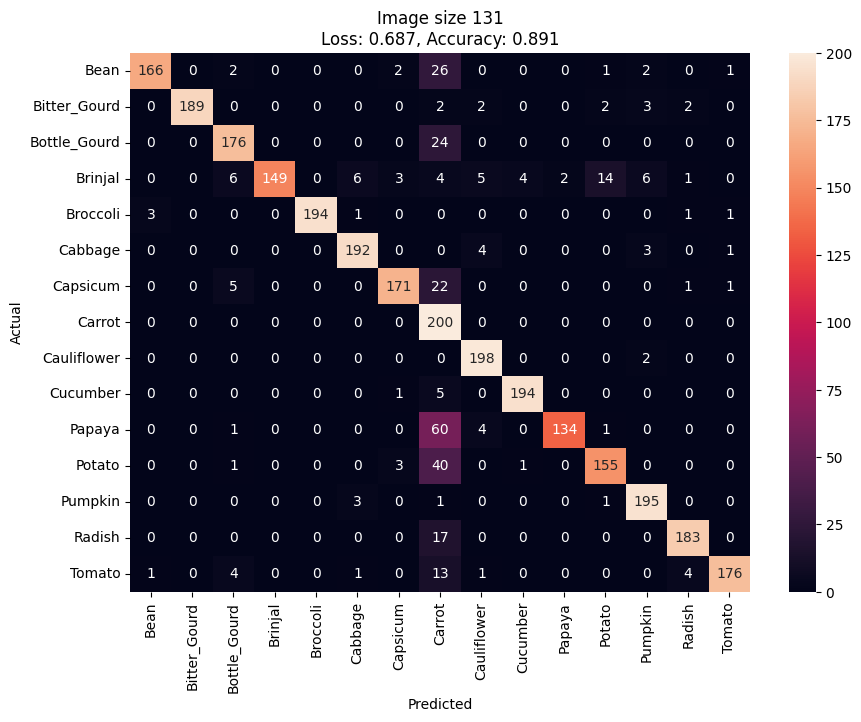

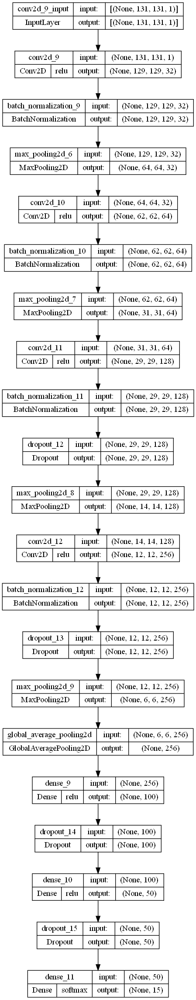

In [41]:
#import model and weights
from tensorflow.keras.models import load_model
from keras.utils.vis_utils import plot_model

model131 = load_model('model131.h5')

model131.load_weights('model131_weights.h5')

model131.summary()

y_pred = model131.predict(X_test131)

from sklearn.metrics import confusion_matrix

confusion_matrix(np.argmax(y_test131, axis=1), np.argmax(y_pred, axis=1))

# Graph the confusion matrix

import seaborn as sns
import pandas as pd

cm = confusion_matrix(np.argmax(y_test131, axis=1), np.argmax(y_pred, axis=1))

pd.options.display.float_format = '{:.2f}'.format

df_cm = pd.DataFrame(cm, index = [i for i in test_dataset_131.class_names],
                    columns = [i for i in test_dataset_131.class_names])

loss, accuracy = model131.evaluate(X_test131, y_test131)

plt.figure(figsize=(10,7))
sns.heatmap(df_cm, annot=True, fmt='d')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title(f'Image size 131\nLoss: {loss:.3f}, Accuracy: {accuracy:.3f}')
plt.show()

plot_model(model131, show_shapes=True, show_layer_names=True, show_layer_activations=True, expand_nested=True)

The 131x131 Model has a loss of 0.687 and an accuracy of 89.1% when tested on the testing data.

From the confusion matrix, you can see that the model misclassifies a lot of data as carrots when it is not with Papaya being the most.